# EE333 - Lab 4

#### Importing Libraries

In [1]:
import numpy as np
import scipy
import scipy.signal as ssig
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

#### Basic Fucntions

In [2]:
def readImage(path):
    img = mpimg.imread(path)
    return img

def dispImg(img):
    plt.figure(figsize=(10,10))
    plt.imshow(img, cmap='gray')
    plt.show()
    
def compareImgs(img1, img2):
    plt.figure(figsize=(20,10))
    plt.subplot(121)
    plt.imshow(img1, cmap='gray')
    plt.subplot(122)
    plt.imshow(img2, cmap='gray')
    plt.show()

## Q1.  Write a function to manually read an RGB image and convert it to a greyscale image.

In [3]:
img = readImage('lenna.tiff')

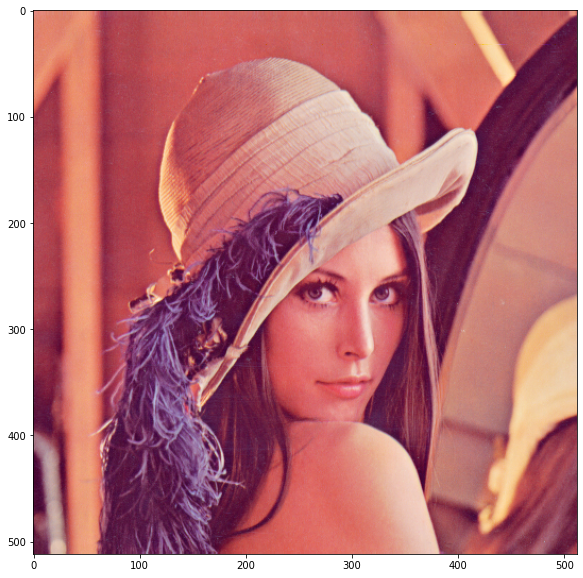

In [4]:
dispImg(img)

In [5]:
def rgb2gray(rgb):
    grayImg = np.array(np.dot(rgb[...,:3], [0.298936021, 0.58704307445, 0.114020904255]), dtype = 'uint8')
    return grayImg

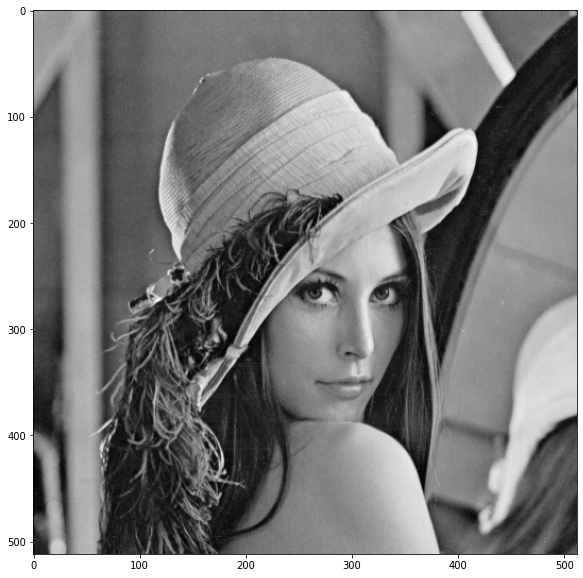

In [6]:
grayImg = rgb2gray(img)

dispImg(grayImg)

## Q2.  Create a GUI to implement Gamma correction on an image using a slider.

In [7]:
def gammaCorrection(img, gamma):
    gammaCorrected = np.array(255*(img / 255) ** gamma, dtype = 'uint8')
    return gammaCorrected

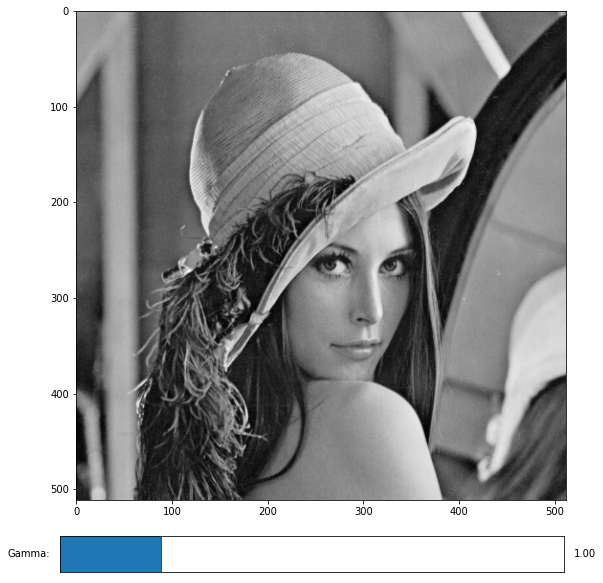

In [8]:
from matplotlib.widgets import Slider, Button

fig = plt.figure(figsize=(10,10))
ax = fig.subplots()
plt.subplots_adjust(bottom=0.2)
im = ax.imshow(grayImg, cmap='gray')
sliderAx = plt.axes([0.15, 0.1, 0.7, 0.05])
gammaSlider = Slider(sliderAx, 'Gamma:',valmin=0.0, valmax=5, valinit=1, valstep=0.05, valfmt='%1.2f')

def updateImg(val):
    im.set_data(gammaCorrection(grayImg, gammaSlider.val))
    plt.draw()

gammaSlider.on_changed(updateImg)

plt.show()

## Q3.  Manually calculate the histogram of a greyscale image and write a code to perform histogram equalization on the image.

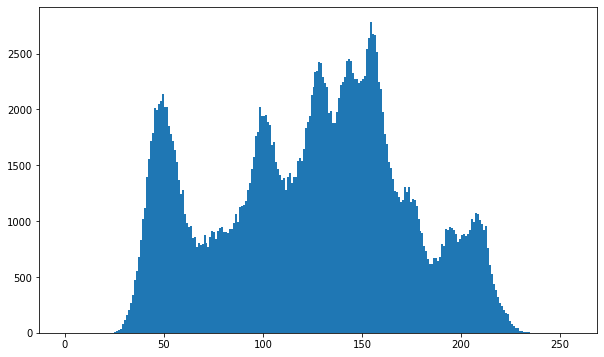

In [9]:
imgFlat = grayImg.flatten()
hist,bins = np.histogram(imgFlat, 256, [0,256])

plt.figure(figsize=(10,6))
plt.hist(imgFlat, 256, [0,256])
plt.show()

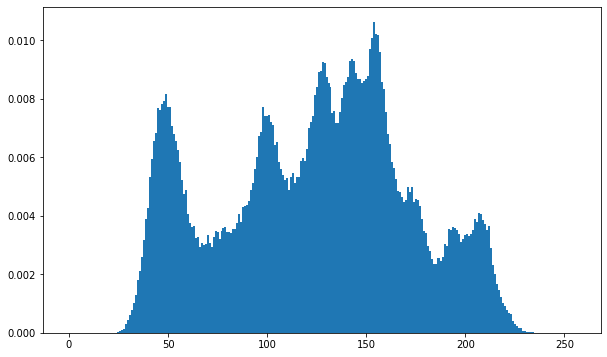

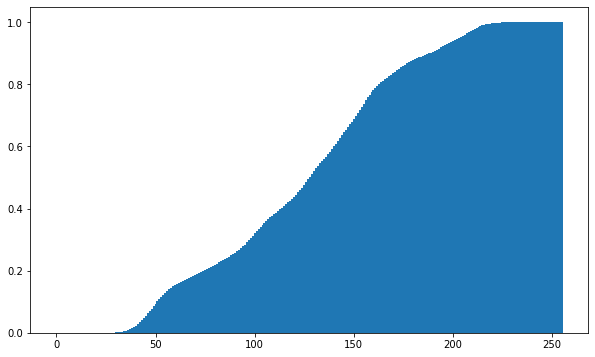

In [10]:
pdf = hist/imgFlat.shape[0]

plt.figure(figsize=(10,6))
plt.bar(bins[:-1], pdf, width=1)
plt.show()

cdf = pdf.cumsum()

plt.figure(figsize=(10,6))
plt.bar(bins[:-1],cdf, width=1)
plt.show()

In [11]:
histEqu = np.array(cdf[grayImg]*255, dtype = 'uint8')

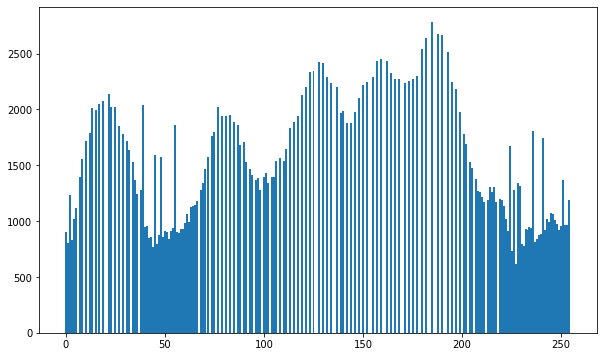

In [12]:
eqImFlat = histEqu.flatten()
eqHist,eqBins = np.histogram(eqImFlat, 256, [0,256])

plt.figure(figsize=(10,6))
plt.bar(eqBins[:-1], eqHist, width=1)
plt.show()

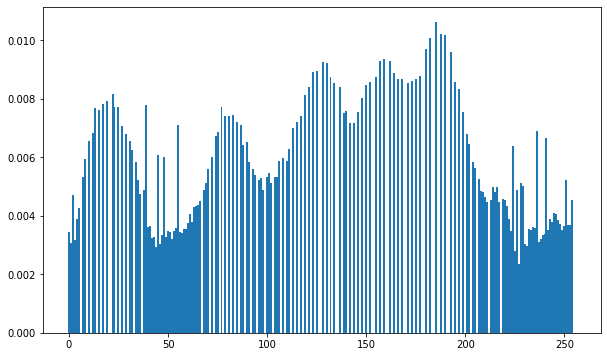

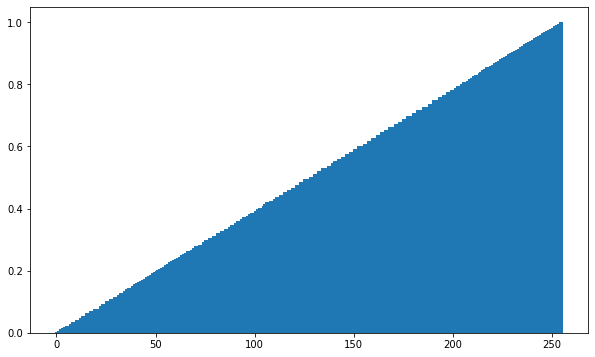

In [13]:
eqPdf = eqHist/eqImFlat.shape[0]

plt.figure(figsize=(10,6))
plt.bar(eqBins[:-1], eqPdf, width=1)
plt.show()

eqCdf = eqPdf.cumsum()

plt.figure(figsize=(10,6))
plt.bar(eqBins[:-1], eqCdf, width=1)
plt.show()

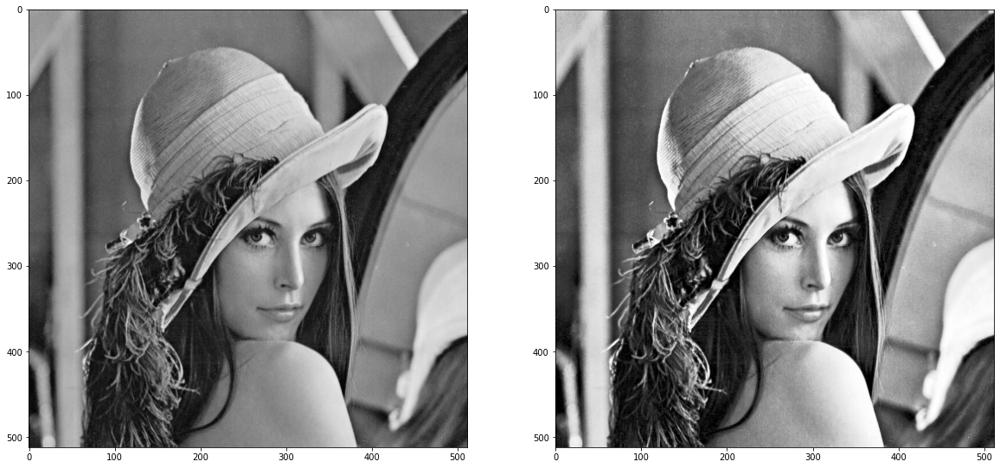

In [14]:
compareImgs(grayImg, histEqu)

In [15]:
def histEqualizer(img):
    imgFlat = img.flatten()
    hist,bins = np.histogram(imgFlat, 256, [0,256])
    pdf = hist/imgFlat.shape[0]
    cdf = pdf.cumsum()
    histEqu = np.array(cdf[img]*255, dtype = 'uint8')
    return histEqu

## Q4.  Implement the following spatial image filters and comment on the effects
### &emsp;1. Laplacian Filtering
### &emsp;2. Gaussian Smoothing
### &emsp;3. Median Filtering

### Laplacian Filtering

In [16]:
laplacianKernel = [[0, 1, 0], [1, -4, 1], [0, 1, 0]]

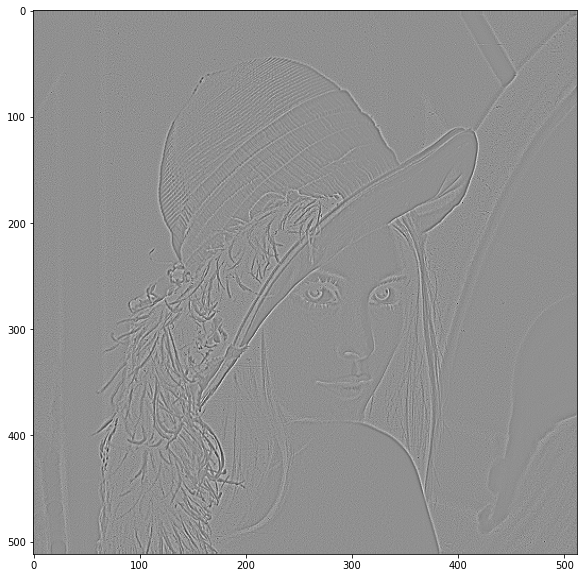

In [17]:
lapFiltOut = ssig.convolve2d(grayImg, laplacianKernel, mode='same', boundary='symm')

dispImg(lapFiltOut)

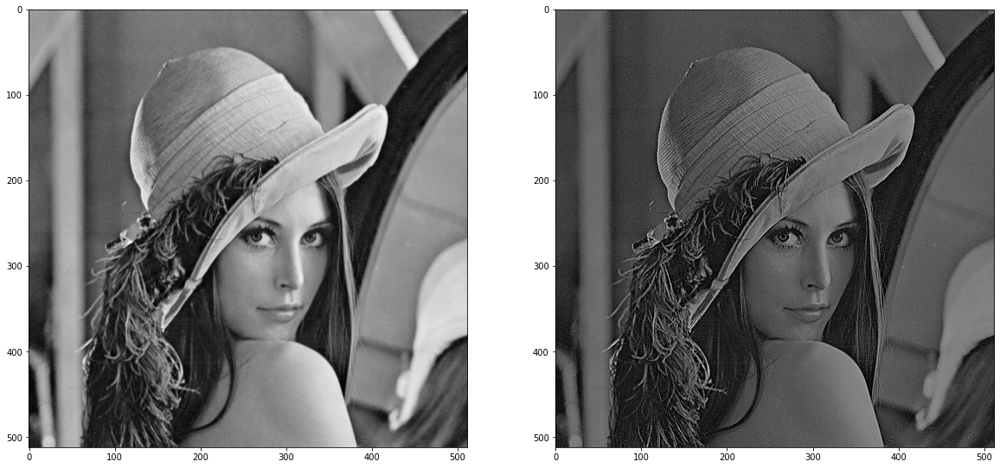

In [18]:
timg = (grayImg - lapFiltOut)
timg[timg < 0] = 0
lapFiltImg = np.array(((timg * 255) / timg.max()), dtype = 'uint8')

compareImgs(grayImg, lapFiltImg)

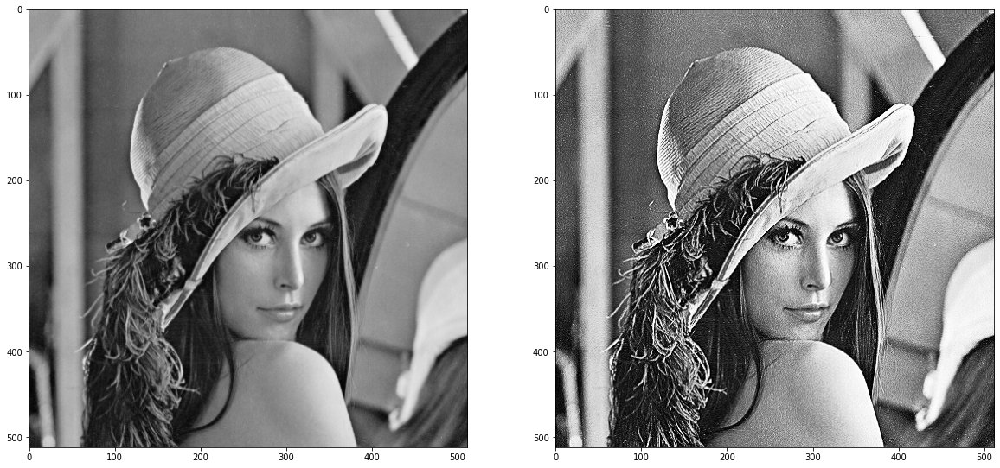

In [19]:
heqlpImg = histEqualizer(lapFiltImg)

compareImgs(grayImg, heqlpImg)

In [20]:
def laplacianFiltering(img, kernel = [[0, 1, 0], [1, -4, 1], [0, 1, 0]]):
    lapFiltOut = ssig.convolve2d(img, kernel, mode='same', boundary='symm')
    timg = (img - lapFiltOut)
    timg[timg < 0] = 0
    lapFiltImg = np.array(((timg * 255) / timg.max()), dtype = 'uint8')
    return lapFiltImg

### Gaussian Smoothing

In [21]:
def zeroMeanGaussian(x,y,sigma):
    return ((1/(2*np.pi*sigma*sigma))*np.exp((-(x*x+y*y))/(2*sigma*sigma)))

def gaussianKernel(ksize=5, sigma=1):
    kernel = np.zeros((ksize,ksize))
    for x in range(ksize):
        for y in range(ksize):
            kernel[x][y] = zeroMeanGaussian(x-ksize//2, y-ksize//2, sigma)
            
    return kernel

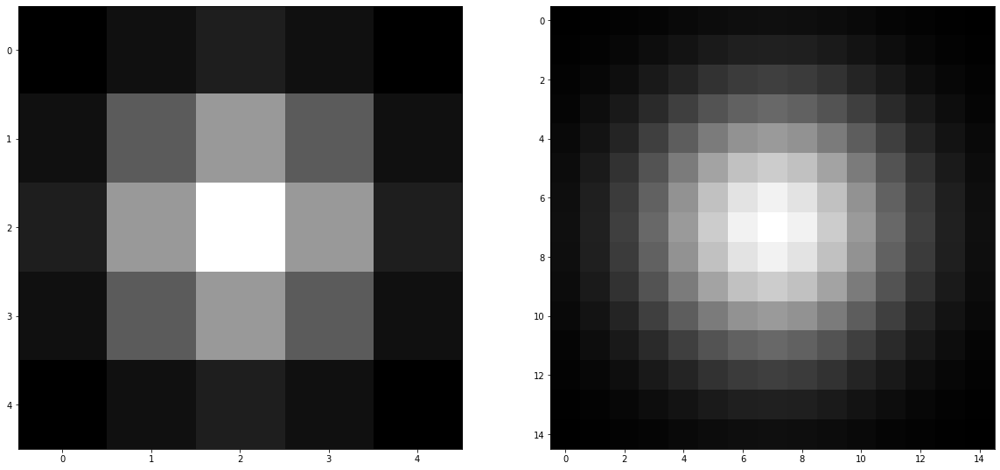

In [22]:
compareImgs(gaussianKernel(5,1), gaussianKernel(15,3))

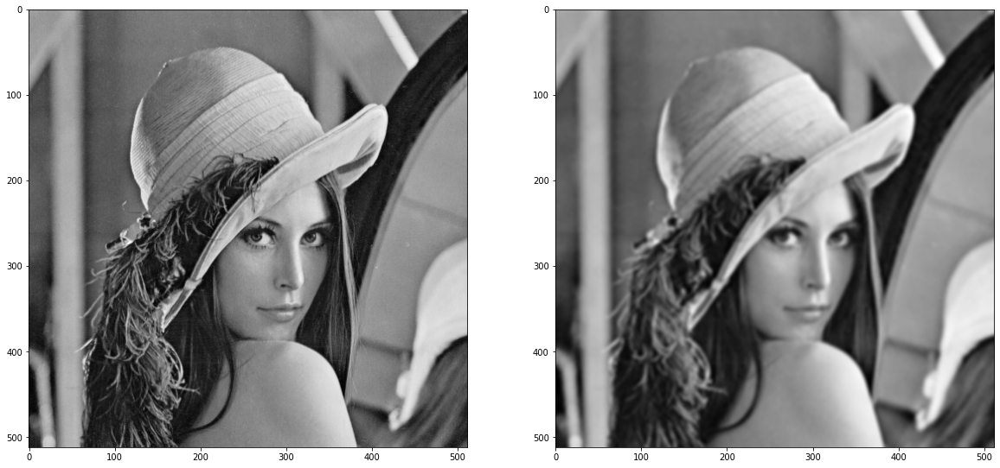

In [23]:
gaussKernel = gaussianKernel(7,2)
timgga = ssig.convolve2d(grayImg, gaussKernel, mode='same', boundary='symm')
gauss_smoothing_img = np.array(((timgga*255)/timgga.max()), dtype = 'uint8')

compareImgs(grayImg, gauss_smoothing_img)

In [24]:
def gaussianSmoothing(img, ksize = 5, sigma = 1):
    gaussKernel = gaussianKernel(ksize,sigma)
    timgg = ssig.convolve2d(img, gaussKernel, mode='same', boundary='symm')
    gauss_smoothing_img = np.array(((timgg*255)/timgg.max()), dtype = 'uint8')
    return gauss_smoothing_img

### Median Filtering

In [25]:
def medianFiltering(img, windowSize = 3):
    assert (windowSize&1 == 1) and (windowSize <= min(img.shape))
    # assuming square window
    
    imgShape = img.shape
    medianFiltered = np.zeros(imgShape)
    window = np.zeros(windowSize**2)
    edge = windowSize//2
    img = np.pad(img, (edge, edge), 'edge')
    
    for x in range(imgShape[0]):
        for y in range(imgShape[1]):
            i=0
            for fx in range(windowSize):
                for fy in range(windowSize):
                    window[i] = img[x+fx][y+fy]
                    i += 1
            
            window.sort()
            medianFiltered[x][y] = window[(windowSize**2)//2]
    
    medianFiltered = np.array(medianFiltered, dtype='uint8')
    return medianFiltered

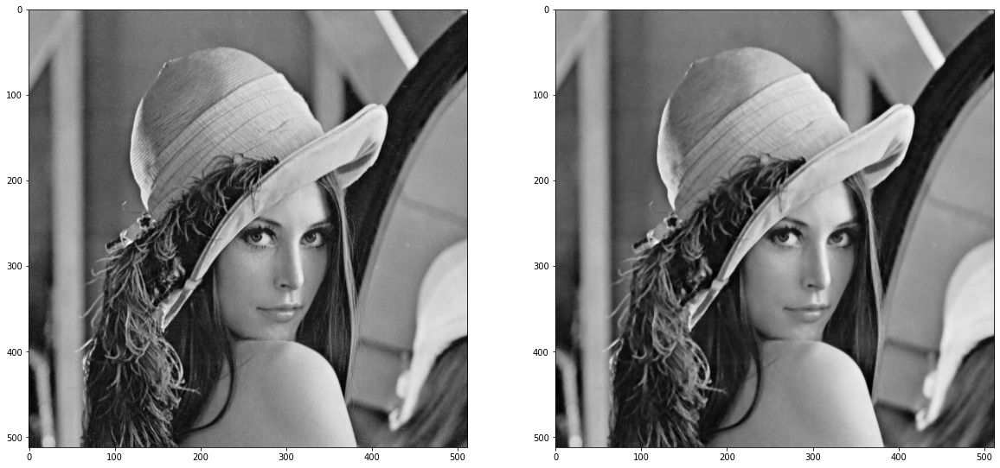

In [26]:
medianOut = medianFiltering(grayImg, 3)

compareImgs(grayImg, medianOut)

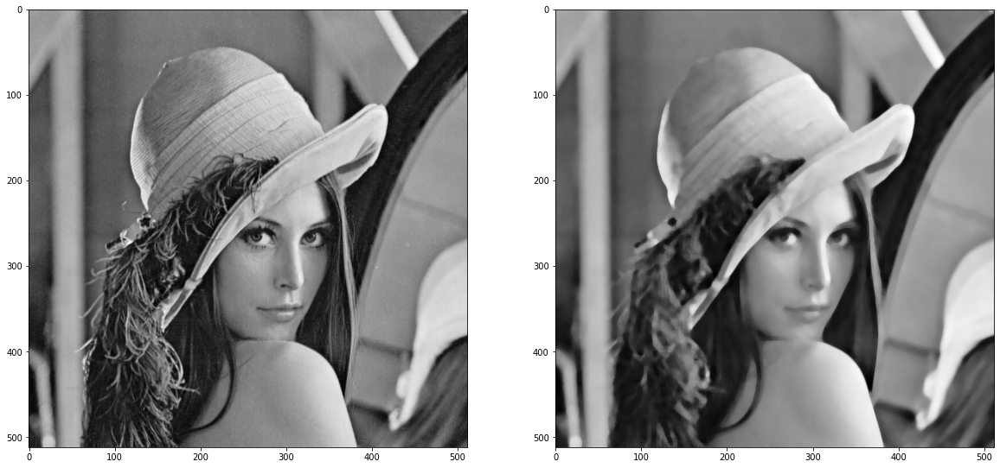

In [27]:
medianOut = medianFiltering(grayImg, 7)

compareImgs(grayImg, medianOut)

## Q5.  Implement the three filters from the previous questions in the frequency domain using the 2D DFT and using the 2D DCT.

### Laplacian Filtering using 2D DFT

In [28]:
from scipy.fft import *

In [29]:
def laplacianFilteringDFT(img, kernel = np.array([[0, 1, 0], [1, -4, 1], [0, 1, 0]])):
    imgDFT = fftn(img)
    kernelPadded = np.pad(kernel, ((0,img.shape[0]-kernel.shape[0]),(0,img.shape[1]-kernel.shape[1])))
    kerDFT = fftn(kernelPadded)
    
    lapImgDFT = imgDFT*kerDFT
    lapFiltImgDFT = imgDFT - lapImgDFT
    
    timgff = np.real(ifftn(lapFiltImgDFT))
    timgff[timgff < 0] = 0
    lapFiltImgff = np.array(((timgff * 255) / timgff.max()), dtype = 'uint8')
    return lapFiltImgff

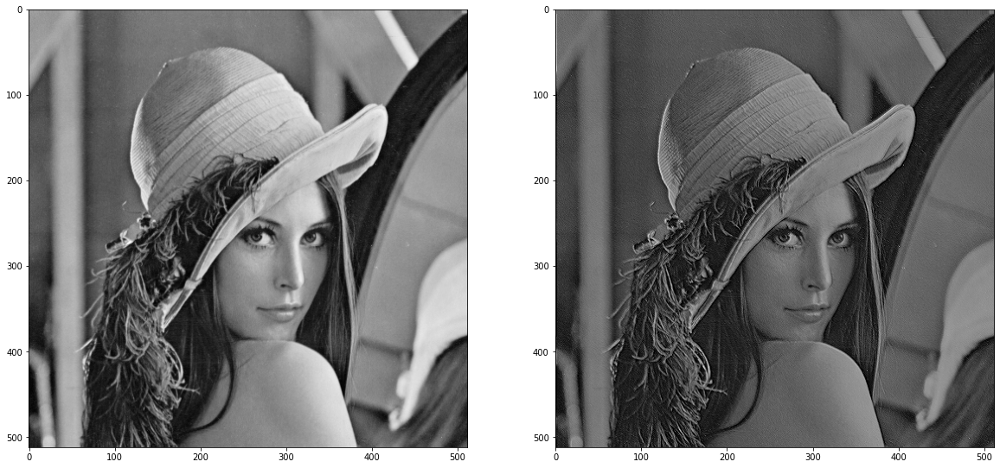

In [30]:
lapFiltImgff = laplacianFilteringDFT(grayImg)

compareImgs(grayImg, lapFiltImgff)

### Laplacian Filtering using 2D DCT

In [31]:
def laplacianFilteringDCT(img, kernel = np.array([[0, 1, 0], [1, -4, 1], [0, 1, 0]])):
    imgDCT = dctn(img)
    kernelPadded = np.pad(kernel, ((0,img.shape[0]-kernel.shape[0]),(0,img.shape[1]-kernel.shape[1])))
    kerDCT= dctn(kernelPadded)
    
    lapImgDCT = imgDCT*kerDCT
    lapFiltImgDCT = imgDCT-lapImgDCT
    
    timgfc = idctn(lapFiltImgDCT)
    timgfc[timgfc < 0] = 0
    lapFiltImgfc = np.array(((timgfc * 255) / timgfc.max()), dtype = 'uint8')
    return lapFiltImgfc

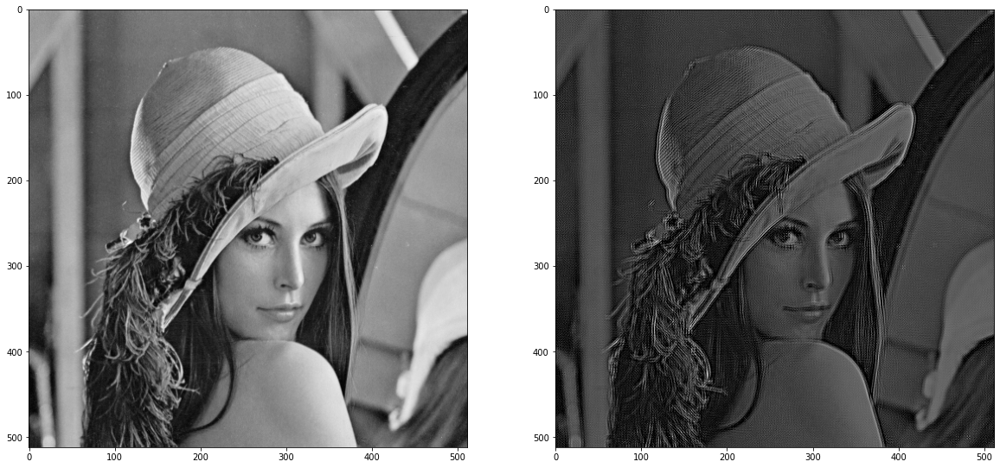

In [32]:
lapFiltImgfc = laplacianFilteringDCT(grayImg)

compareImgs(grayImg, lapFiltImgfc)

### Gaussian Smoothing using 2D DFT

In [33]:
def padToShape(img, shape):
    return np.pad(img, ((0, shape[0]-img.shape[0]),(0, shape[1]-img.shape[1])))

In [34]:
def gaussianSmoothingDFT(img, ksize = 5, sigma = 1):
    assert (ksize&1 == 1) and (ksize <= min(img.shape))
    gaussKernel = gaussianKernel(ksize,sigma)
    kerPadded = np.pad(gaussKernel, ((0,img.shape[0]-gaussKernel.shape[0]),(0,img.shape[1]-gaussKernel.shape[1])))
    imgDFT = fftn(img)
    kerDFT = fftn(kerPadded)

    gaussImgDFT = imgDFT*kerDFT

    gaussImg = np.real(ifftn(gaussImgDFT))
    gaussImgff = np.array(((gaussImg*255)/gaussImg.max()), dtype='uint8')
    return gaussImgff

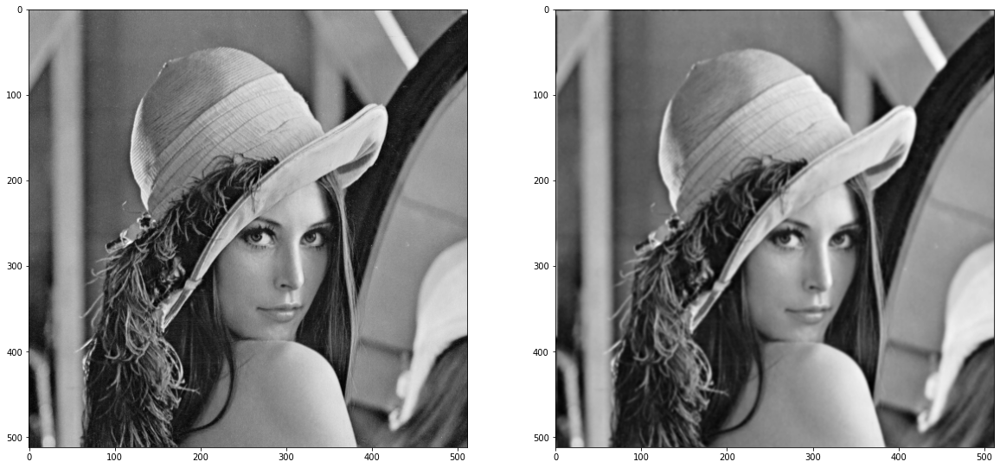

In [35]:
gauss_smoothing_imgff = gaussianSmoothingDFT(grayImg, 5, 1)

compareImgs(grayImg, gauss_smoothing_imgff)

### Gaussian Smoothing using 2D DCT

In [36]:
def gaussianSmoothingDCT(img, ksize = 5, sigma = 1):
    assert (ksize&1 == 1) and (ksize <= min(img.shape))
    gaussKernel = gaussianKernel(ksize,sigma)
    kerPadded = np.pad(gaussKernel, ((0,img.shape[0]-gaussKernel.shape[0]),(0,img.shape[1]-gaussKernel.shape[1])))
    imgDCT = dctn(img)
    kerDCT = dctn(kerPadded)

    gaussImgDCT = imgDCT*kerDCT
    
    gaussImg = idctn(gaussImgDCT)
    gaussImgfc = np.array(((gaussImg*255)/gaussImg.max()), dtype='uint8')
    return gaussImgfc

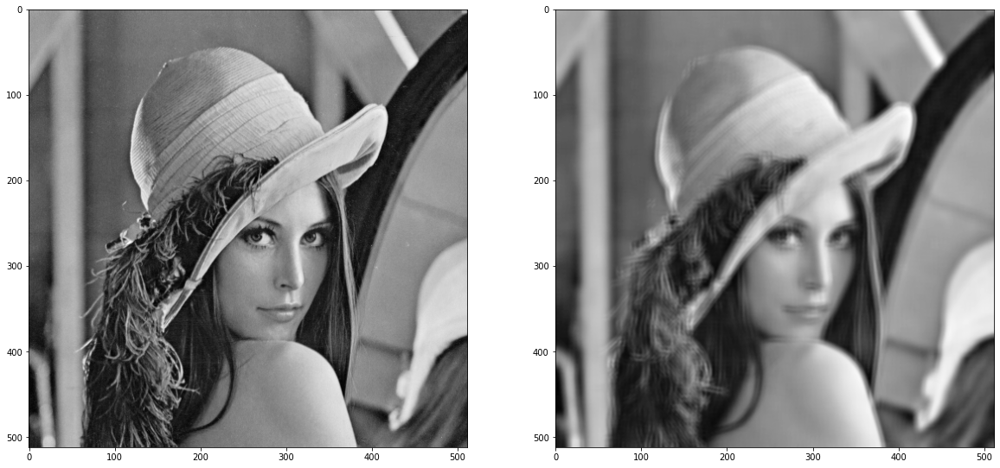

In [37]:
gauss_smoothing_imgfc = gaussianSmoothingDCT(grayImg, 5, 1)

compareImgs(grayImg, gauss_smoothing_imgfc)

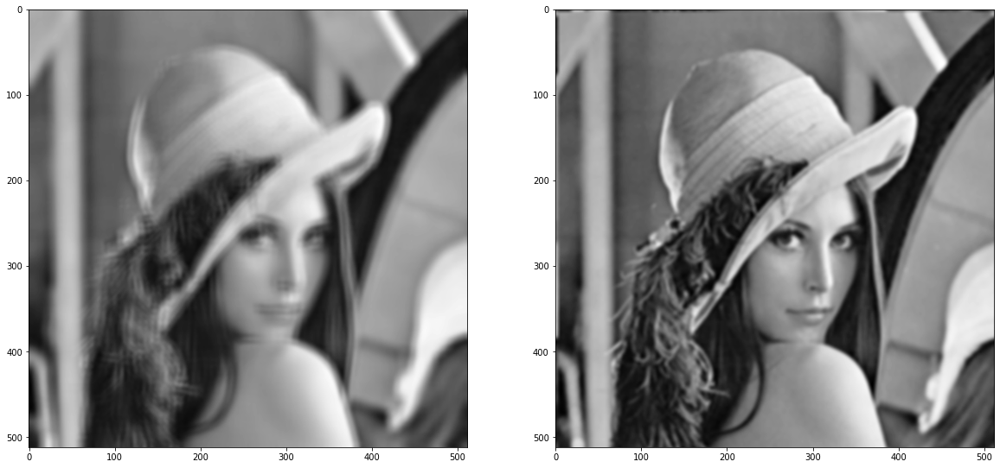

In [38]:
compareImgs(gaussianSmoothingDCT(grayImg, 7, 2), gaussianSmoothingDFT(grayImg, 7, 2))

## Q6.  Add salt and pepper noise to the image in question and perform the filtering operations from questions 4 and 5, and comment on the PSNR (peak signal to noise ratio) with and without filtering.

In [39]:
def addSaltPepperNoise(img, percent_of_noise):
    noiseImg = img.copy()
    n = int((img.size)*(percent_of_noise/100))
    x = np.random.randint(0, img.shape[0]-1, n)
    y = np.random.randint(0, img.shape[1]-1, n)
    for i in range(n):
        noiseImg[x[i]][y[i]] = 0 if (np.random.rand()>0.5) else 255
        
    return noiseImg

In [40]:
def mse(img, noiseImg):
    return np.sum((np.square(img - noiseImg)))/(img.size)

In [41]:
def psnr(img, noiseImg, maxPixel=255):
    MSE = mse(img, noiseImg)
    return (20*np.log10(maxPixel) - 10*np.log10(MSE))

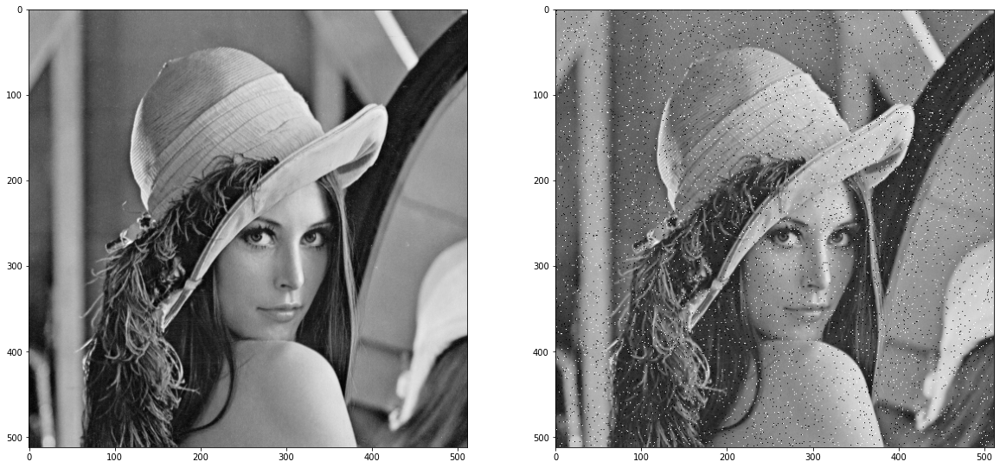

In [42]:
compareImgs(grayImg, addSaltPepperNoise(grayImg, 3))

In [43]:
psnr(grayImg, addSaltPepperNoise(grayImg, 3))

43.15067379043998

In [44]:
noiseImg = addSaltPepperNoise(grayImg, 3)

### Laplcian Filtering

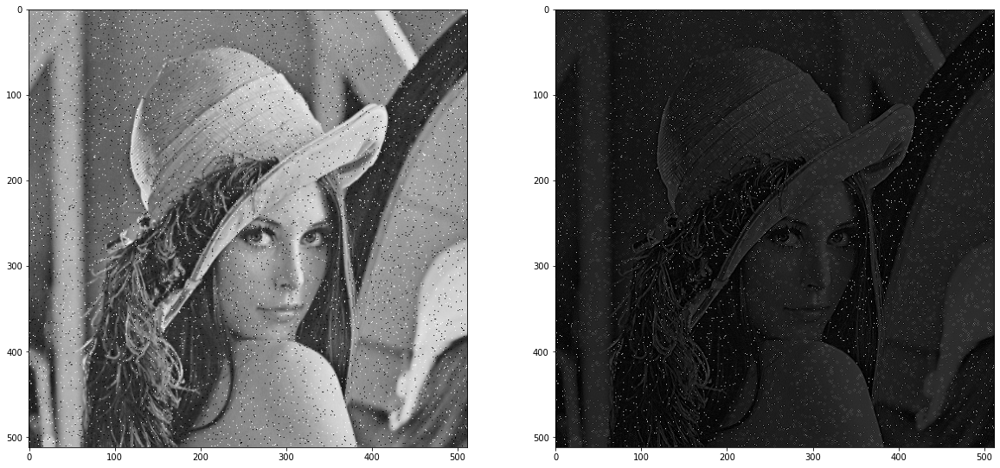

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  27.876207152466133


In [45]:
compareImgs(noiseImg, laplacianFiltering(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, laplacianFiltering(noiseImg)))

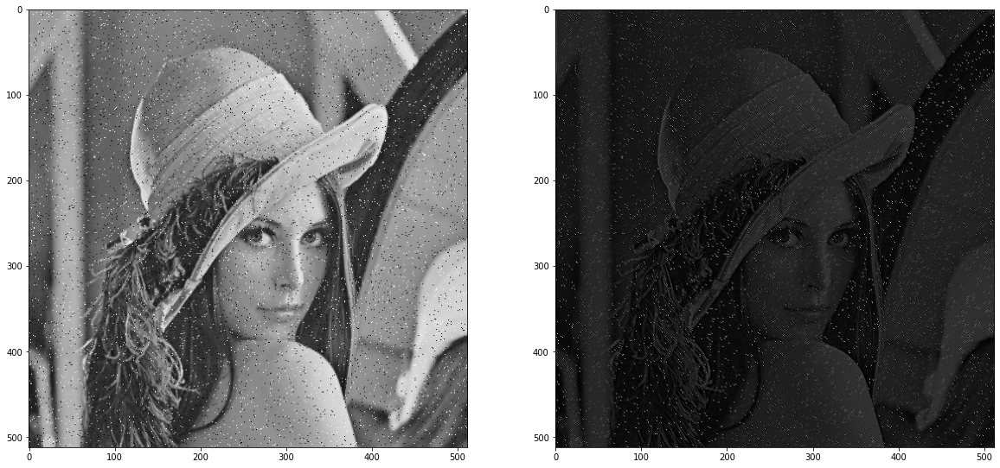

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  27.87475032771448


In [46]:
compareImgs(noiseImg, laplacianFilteringDFT(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, laplacianFilteringDFT(noiseImg)))

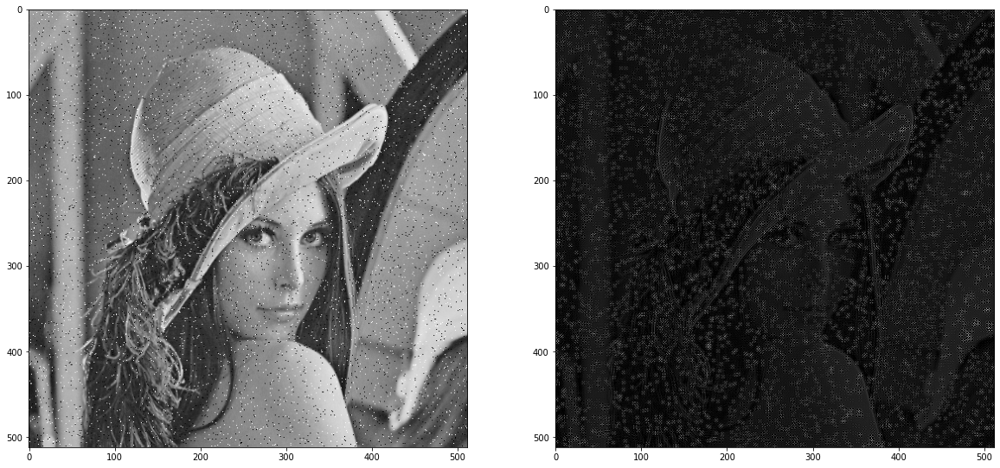

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  27.909727688444878


In [47]:
compareImgs(noiseImg, laplacianFilteringDCT(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, laplacianFilteringDCT(noiseImg)))

### Gaussian Smoothing

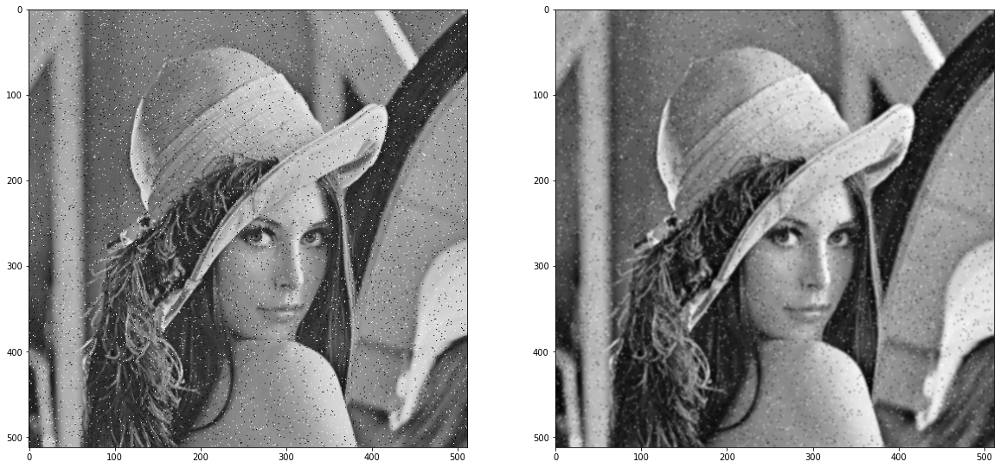

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  28.299220593865456


In [48]:
compareImgs(noiseImg, gaussianSmoothing(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, gaussianSmoothing(noiseImg)))

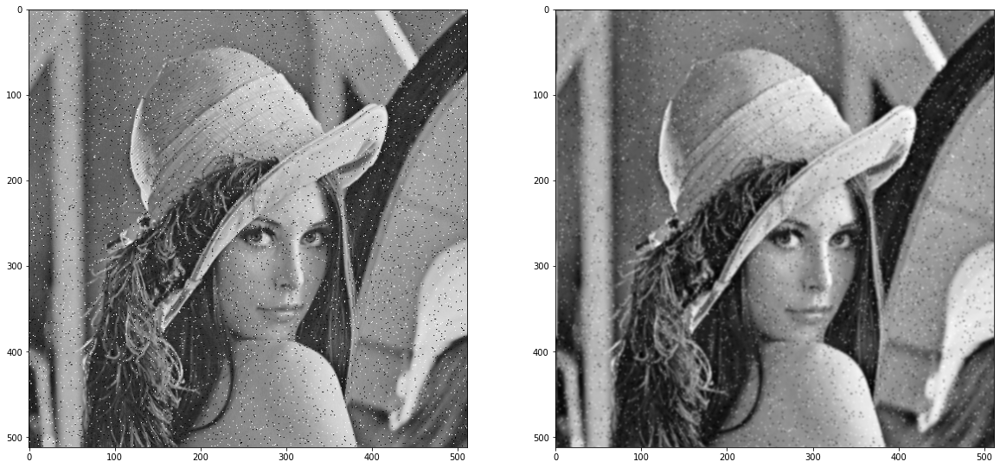

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  28.36731060640632


In [49]:
compareImgs(noiseImg, gaussianSmoothingDFT(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, gaussianSmoothingDFT(noiseImg)))

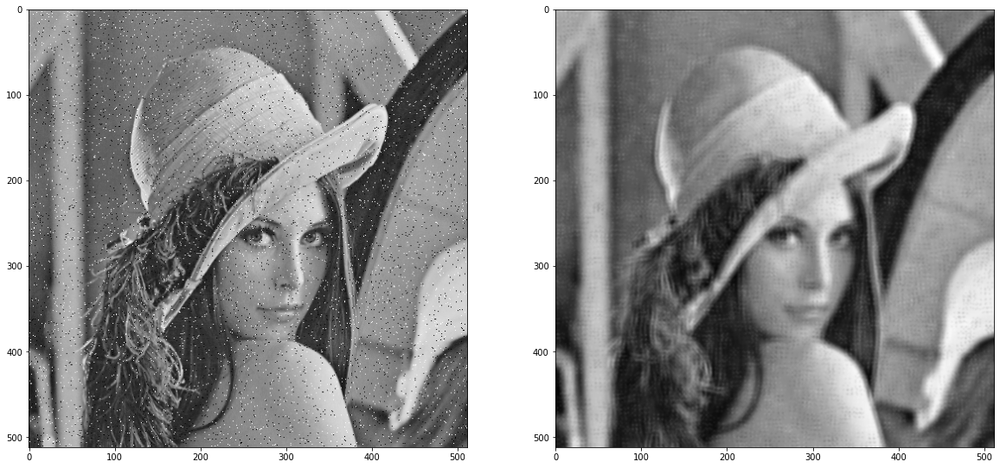

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  27.843063832427575


In [50]:
compareImgs(noiseImg, gaussianSmoothingDCT(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, gaussianSmoothingDCT(noiseImg)))

### Median Filtering

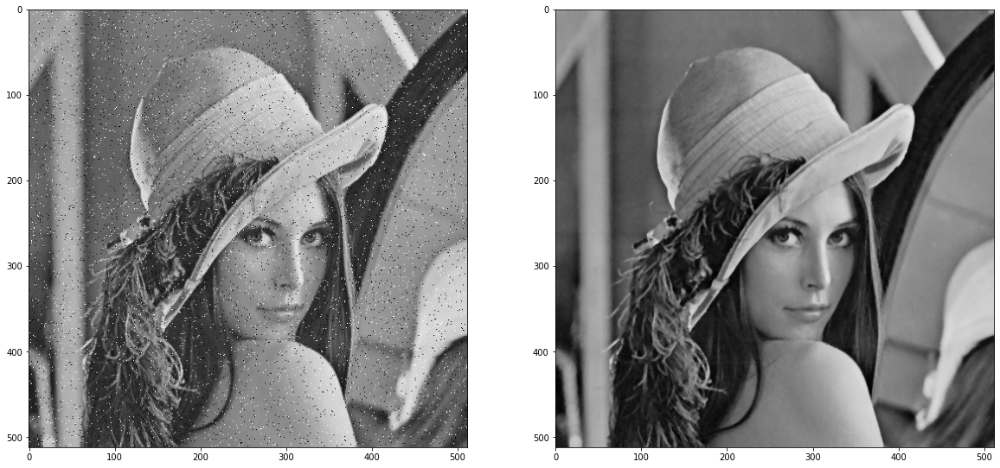

PSNR of noisy image:  43.16404124936355
PSNR of filtered image:  37.08505302173636


In [51]:
compareImgs(noiseImg, medianFiltering(noiseImg))
print('PSNR of noisy image: ', psnr(grayImg, noiseImg))
print('PSNR of filtered image: ', psnr(grayImg, medianFiltering(noiseImg)))

## Q7. Implement the following algorithm
    1. Take the DCT of an image.
    2. Choose only the first K low frequency components and force everything else to zero.
    3. Reconstruct the image using these low frequency components and calculate the PSNR.
    4. Plot the PSNR as a function of K and record your observations.

In [52]:
def kthLowFreq(imgDCT, k):
    assert k < imgDCT.size
    sortedDCT = np.sort(imgDCT.flatten())
    return sortedDCT[k]

In [53]:
def maskFreqAboveK(imgDCT, k):
    timg = imgDCT.copy()
    kFreq = kthLowFreq(imgDCT, k)
    timg[timg > kFreq] = 0
    return timg

In [54]:
imgDCT = dctn(grayImg)

In [55]:
grayImg.size

262144

In [56]:
def imgLowKFreq(img, k):
    imgDCT = dctn(img)
    low_freq_img_DCT = maskFreqAboveK(imgDCT, k)
    lowFreqImg = idctn(low_freq_img_DCT)
    return lowFreqImg

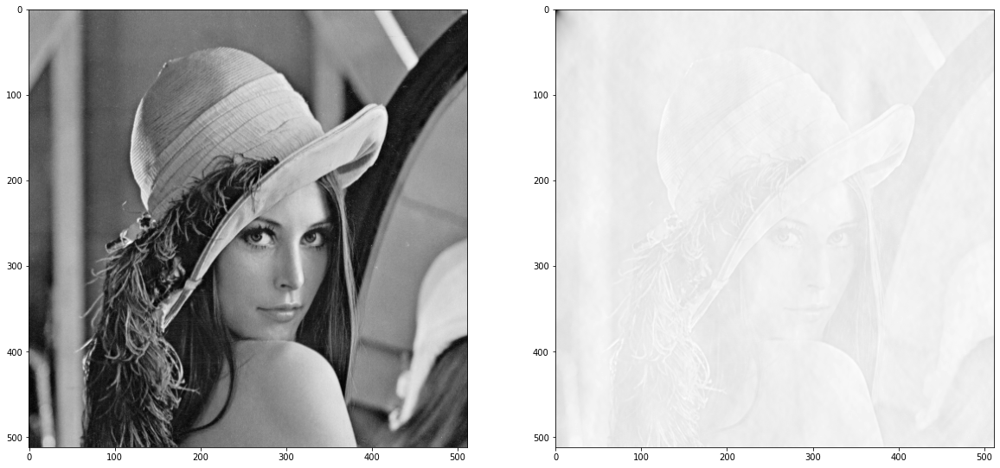

5.975988826461666

In [57]:
low_freq_img_DCT = maskFreqAboveK(imgDCT, k=260000)
lowFreqImg = idctn(low_freq_img_DCT)
compareImgs(grayImg, lowFreqImg)
psnr(grayImg, lowFreqImg)

In [58]:
karr = np.linspace(1,200000,500, dtype = int)
karr = np.concatenate((karr, np.linspace(200001, grayImg.size-5, 500, dtype = int)))

In [59]:
reconstructedImgs = np.zeros((karr.size, grayImg.shape[0], grayImg.shape[1]))
psnrArr = np.zeros(karr.size)
for i, k in enumerate(karr):
    reconstructedImgs[i] = imgLowKFreq(grayImg, k)
    psnrArr[i] = psnr(grayImg, reconstructedImgs[i])

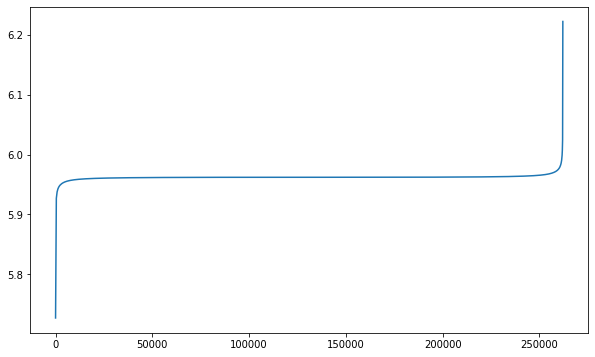

In [60]:
plt.figure(figsize=(10,6))
plt.plot(karr, psnrArr)
plt.show()

In [61]:
def kthHighFreq(imgDCT, k):
    assert k < imgDCT.size
    sortedDCT = np.sort(imgDCT.flatten())[::-1]
    return sortedDCT[k]

In [62]:
def maskFreqBetween(imgDCT, k):
    assert k < imgDCT.size/2
    timg1 = imgDCT.copy()
    timg2 = imgDCT.copy()
    kLFreq = kthLowFreq(imgDCT, k)
    kHFreq = kthHighFreq(imgDCT, k)
    timg1[timg1 > kLFreq] = 0
    timg2[timg2 < kHFreq] = 0
    return timg1+timg2

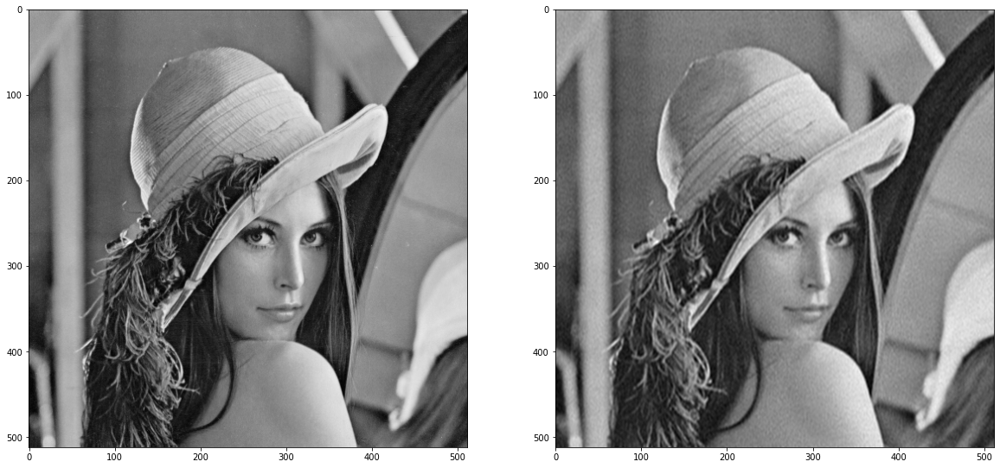

33.22296770427657

In [63]:
cut_freq_img_DCT = maskFreqBetween(imgDCT, k=10000)
cutFreqImg = idctn(cut_freq_img_DCT)
compareImgs(grayImg, cutFreqImg)
psnr(grayImg, cutFreqImg)

## Q8. Repeat Question 6 using 8 x 8 blocks of the image.

### Laplacian Flitering

In [64]:
def laplacianFilteringB(img, kernel = [[0, 1, 0], [1, -4, 1], [0, 1, 0]]):
    x = 0
    y = 0
    lapFiltImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            lapFiltImg[x:x+8, y:y+8] = laplacianFiltering(img[x:x+8, y:y+8])
            y += 8
        y = 0
        x += 8
    return lapFiltImg

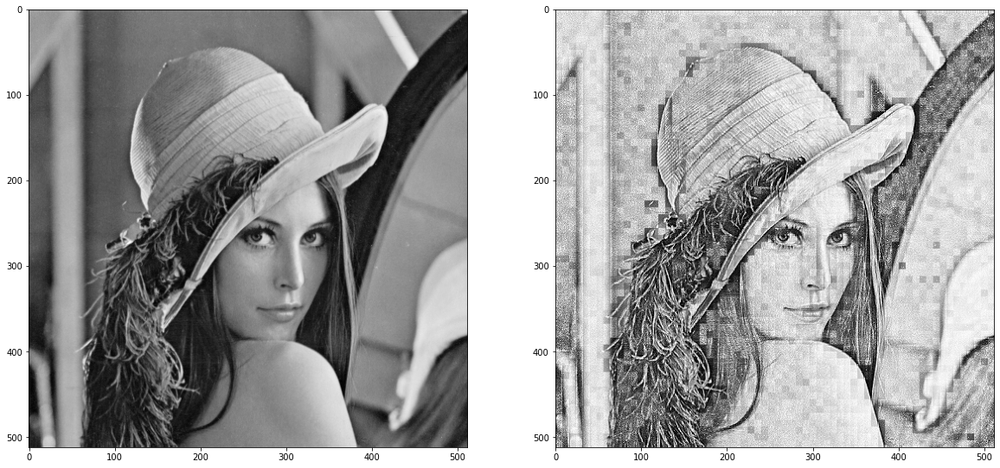

In [65]:
compareImgs(grayImg, laplacianFilteringB(grayImg))

In [66]:
def laplacianFilteringDFTB(img, kernel = [[0, 1, 0], [1, -4, 1], [0, 1, 0]]):
    x = 0
    y = 0
    lapFiltImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            lapFiltImg[x:x+8, y:y+8] = laplacianFilteringDFT(img[x:x+8, y:y+8])
            y += 8
        y = 0
        x += 8
    return lapFiltImg

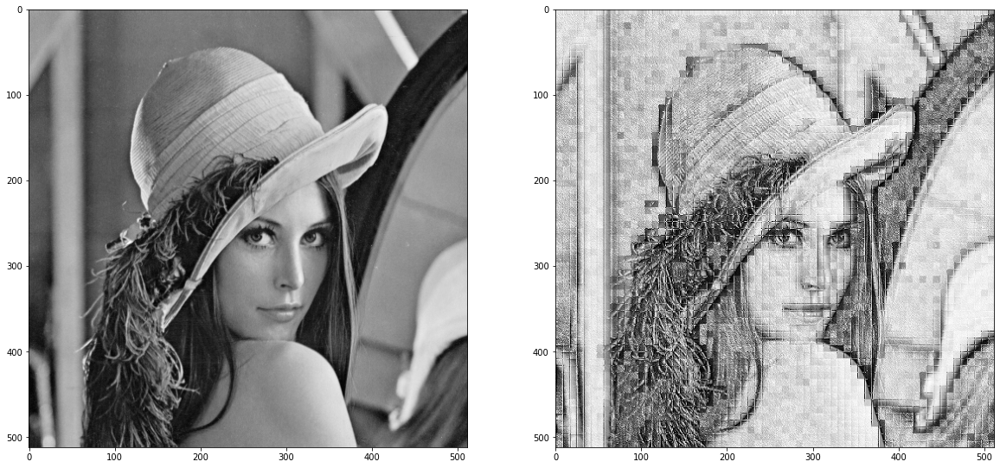

In [67]:
compareImgs(grayImg, laplacianFilteringDFTB(grayImg))

In [68]:
def laplacianFilteringDCTB(img, kernel = [[0, 1, 0], [1, -4, 1], [0, 1, 0]]):
    x = 0
    y = 0
    lapFiltImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            lapFiltImg[x:x+8, y:y+8] = laplacianFilteringDCT(img[x:x+8, y:y+8])
            y += 8
        y = 0
        x += 8
    return lapFiltImg

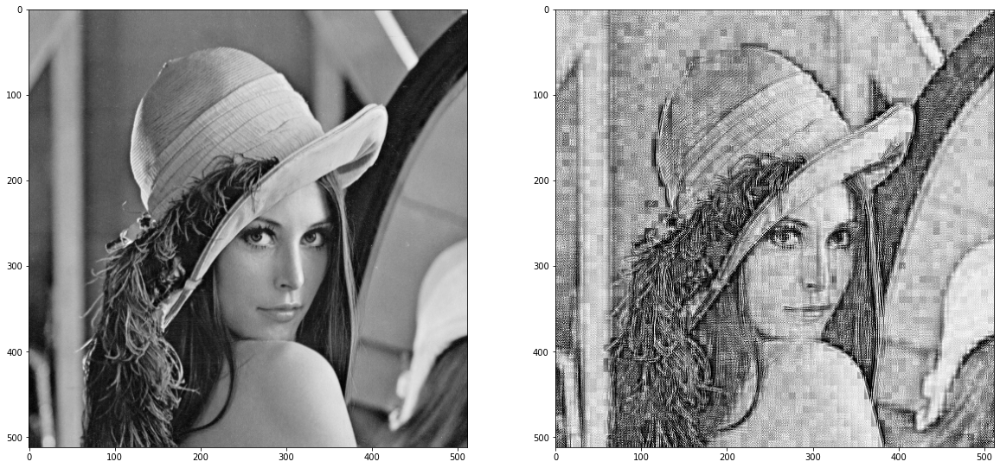

In [69]:
compareImgs(grayImg, laplacianFilteringDCTB(grayImg))

### Gaussian Smoothing

In [70]:
def gaussianSmoothingB(img, ksize = 5, sigma = 1):
    x = 0
    y = 0
    GaussSmoothImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            GaussSmoothImg[x:x+8, y:y+8] = gaussianSmoothing(img[x:x+8, y:y+8], ksize, sigma)
            y += 8
        y = 0
        x += 8
    return GaussSmoothImg

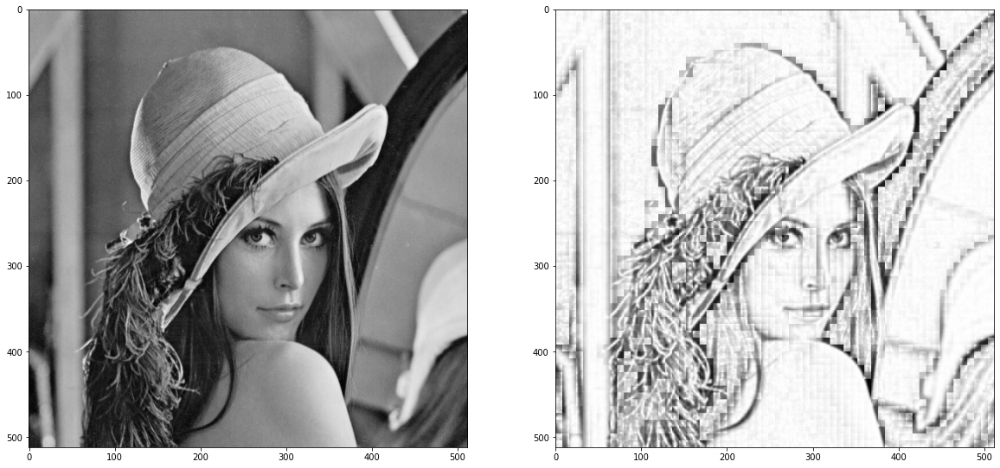

In [71]:
compareImgs(grayImg, gaussianSmoothingB(grayImg))

In [72]:
def gaussianSmoothingDFTB(img, ksize = 5, sigma = 1):
    x = 0
    y = 0
    GaussSmoothImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            GaussSmoothImg[x:x+8, y:y+8] = gaussianSmoothingDFT(img[x:x+8, y:y+8], ksize, sigma)
            y += 8
        y = 0
        x += 8
    return GaussSmoothImg

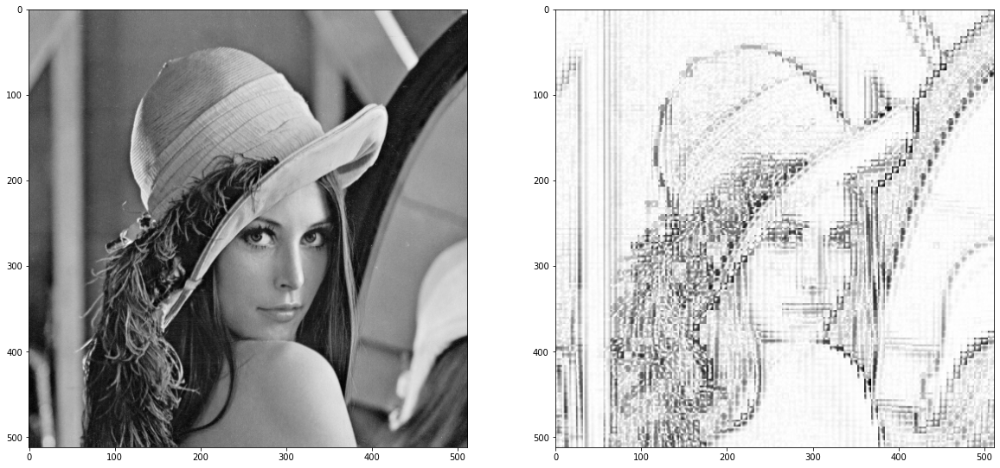

In [73]:
compareImgs(grayImg, gaussianSmoothingDFTB(grayImg))

In [74]:
def gaussianSmoothingDCTB(img, ksize = 5, sigma = 1):
    x = 0
    y = 0
    GaussSmoothImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            GaussSmoothImg[x:x+8, y:y+8] = gaussianSmoothingDCT(img[x:x+8, y:y+8], ksize, sigma)
            y += 8
        y = 0
        x += 8
    return GaussSmoothImg

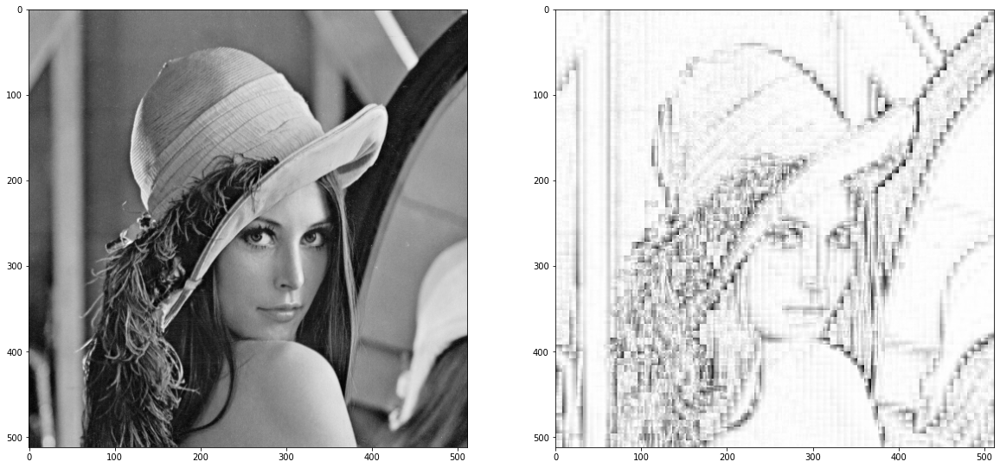

In [75]:
compareImgs(grayImg, gaussianSmoothingDCTB(grayImg))

### Median Filtering

In [76]:
def medianFilteringB(img, windowSize = 3):
    x = 0
    y = 0
    medianFiltImg = np.zeros(img.shape)
    while x < img.shape[0]-1:
        while y < img.shape[1]-1:
            medianFiltImg[x:x+8, y:y+8] = medianFiltering(img[x:x+8, y:y+8], windowSize)
            y += 8
        y = 0
        x += 8
    return medianFiltImg

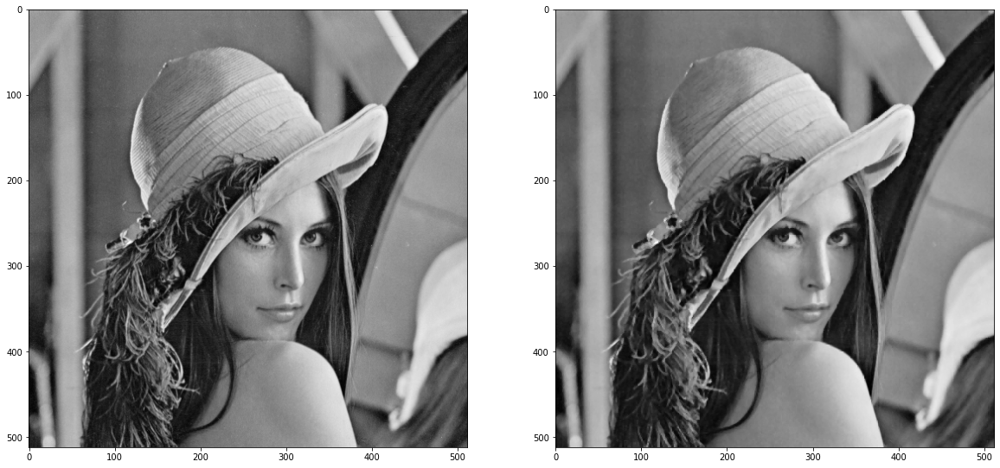

In [77]:
compareImgs(grayImg, medianFilteringB(grayImg))

## Playing Around

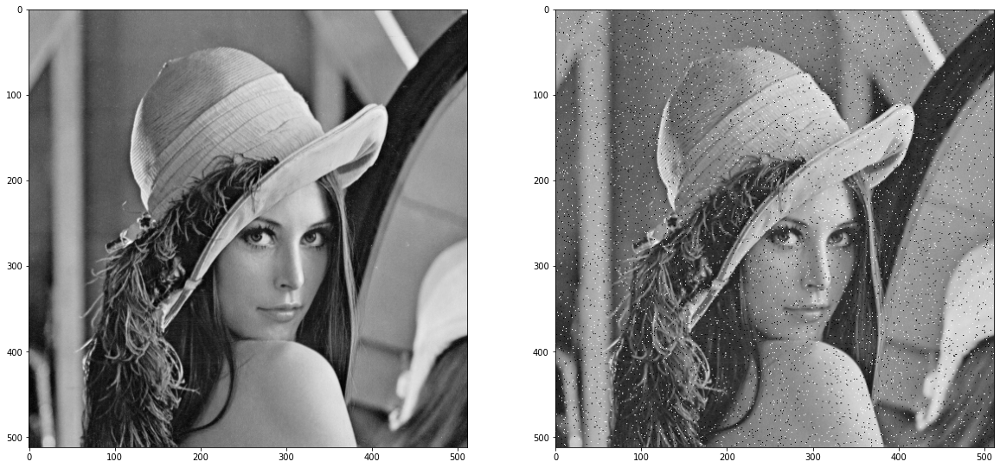

In [78]:
noisyImg = addSaltPepperNoise(grayImg, 3)
compareImgs(grayImg, noisyImg)

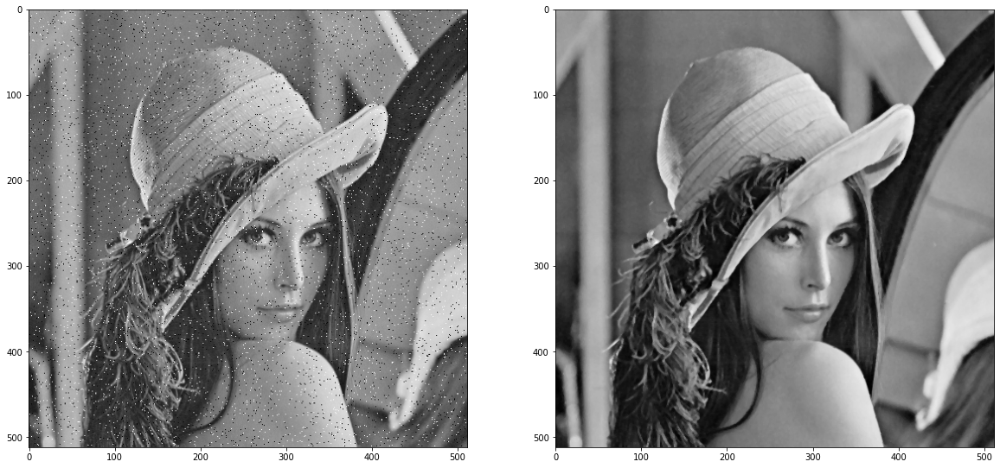

In [79]:
medianFiltered = medianFiltering(noisyImg)
compareImgs(noisyImg, medianFiltered)

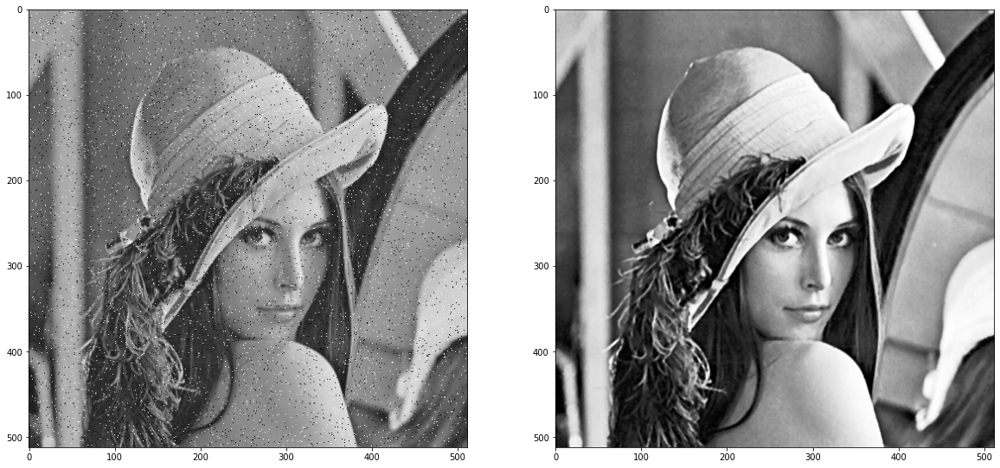

In [80]:
finalOut = histEqualizer(laplacianFiltering(gaussianSmoothing(medianFiltered, 5, 1)))
compareImgs(noisyImg, finalOut)

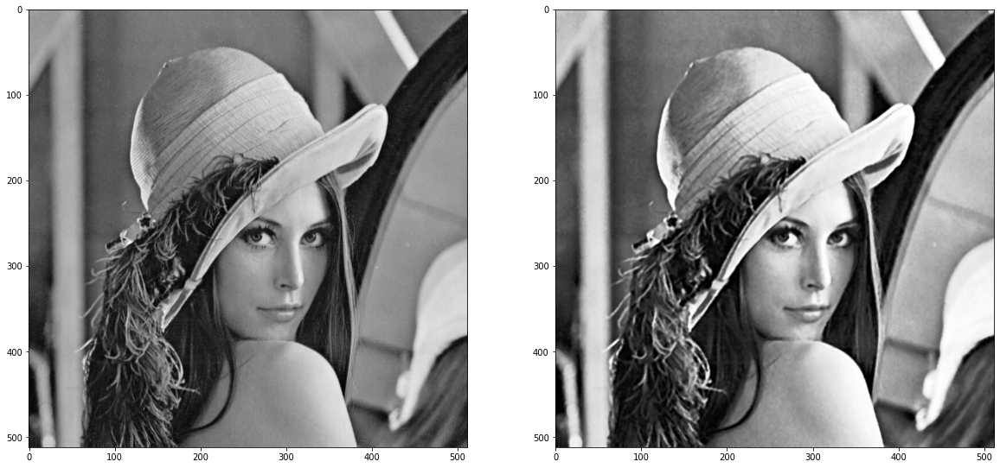

In [81]:
compareImgs(grayImg, finalOut)